<a href="https://colab.research.google.com/github/DSAishwaryaG/Claim_Prediction/blob/main/Medical.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [101]:
import pandas as pd
import matplotlib.pyplot as plt
%config InlineBackend.figure_format = 'retina'

In [102]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [103]:

!python --version

Python 3.7.10


In [104]:
df=pd.read_csv('/content/gdrive/My Drive/Project_Datasets/Medical_Claims.csv',encoding='latin1',nrows=10000) #encoding(latin1,gbk,utf8) is used to resolve UnicodeDecodeError: 'utf-8' codec can't decode byte 0xaa in position 100: invalid start byte
#Python pandas will read a csv file using utf-8 encoding defautly. However, if the character encoding of this csv file is not utf-8, UnicodeDecodeError may occur.


In [105]:
df.describe()

,ClaimID,TotalPaid_End,TotalReserves_End,TotalRecovery_End,IndemnityPaid,OtherPaid,AverageWeeklyWage,IsDenied,ClaimantAge_at_DOI
count,10000.000000,1.000000e+04,10000.000000,10000.000000,10000.000000,10000.000000,2003.000000,10000.000000,2556.000000
mean,765521.950200,4.934402e+03,859.007280,42.548726,2644.760415,2289.641674,465.266450,0.038700,31.249218
std,4709.953749,3.219289e+04,16919.526116,944.972153,19998.009134,15545.837043,1283.768043,0.192889,246.869823
min,633915.000000,-6.000000e-02,0.000000,0.000000,0.000000,-0.060000,1.000000,0.000000,-7163.000000
25%,763123.750000,5.668000e+01,0.000000,0.000000,0.000000,55.602500,315.070000,0.000000,32.000000
50%,765623.500000,1.943900e+02,0.000000,0.000000,0.000000,192.075000,446.630000,0.000000,40.000000
75%,768123.250000,5.854850e+02,0.000000,0.000000,0.000000,549.242500,591.365000,0.000000,47.000000
max,770623.000000,1.012858e+06,598796.550000,64850.000000,434574.000000,734983.100000,56140.000000,1.000000,82.000000


In [106]:
df.head(3)

,ClaimID,TotalPaid_End,TotalReserves_End,TotalRecovery_End,IndemnityPaid,OtherPaid,ClaimantStatus_End,IncidentDate,IncidentDescription,EmploymentStartDate,ReturnToWorkDate,AverageWeeklyWage,ClaimOpenedDate,ClaimClosedDate,EmployerNotificationDate,ClaimReceivedDate,IsDenied,OSHAInjuryDescription,ClaimantAge_at_DOI,Gender,ClaimantType,InjuryCause,InjuryNature,BodyPartRegion,BodyPart
0,633915,11947.55,0.0,0.0,243.65,11703.90,C,6/17/2009,Employee was moving concrete rings and installing a meter. He strained lower back.,5/24/2004,12/8/2009,639.59,7/2/2009,7/20/2010,6/29/2009,7/2/2009,0,Employee was moving concrete rings- strained lower back.,49.0,Male,Indemnity,Heavy Object,Strain,Trunk,Lower Back Area
1,633916,0.00,0.0,0.0,0.00,0.00,C,6/26/2009,Employee was pulling lining. He felt a pop in the back causing a strain.,8/13/2004,6/26/2009,NaN,7/2/2009,11/25/2009,7/1/2009,7/2/2009,0,Employee Was Pulling Lining. He Felt A Pop In The Back Causing A Strain.,49.0,Male,Medical Only,Bodily Motion,Strain,Trunk,Lower Back Area
2,633917,9295.89,0.0,0.0,0.00,9295.89,C,6/25/2009,Employee was in the restroom. He heard a scream from another restroom that startled him and he fell on his left hand causing a fracture. (),4/16/1990,7/13/2009,1649.00,7/2/2009,3/30/2010,6/25/2009,7/2/2009,0,"Startled by another person, fell onto left hand",47.0,Male,Indemnity,Other Person,Fracture,Upper Extremities,Hand


In [107]:
df['IsDenied'].value_counts()

0    9613
1     387
Name: IsDenied, dtype: int64

In [206]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 25 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   ClaimID                   10000 non-null  int64  
 1   TotalPaid_End             10000 non-null  float64
 2   TotalReserves_End         10000 non-null  float64
 3   TotalRecovery_End         10000 non-null  float64
 4   IndemnityPaid             10000 non-null  float64
 5   OtherPaid                 10000 non-null  float64
 6   ClaimantStatus_End        10000 non-null  object 
 7   IncidentDate              10000 non-null  object 
 8   IncidentDescription       10000 non-null  object 
 9   EmploymentStartDate       10000 non-null  object 
 10  ReturnToWorkDate          10000 non-null  object 
 11  AverageWeeklyWage         2003 non-null   float64
 12  ClaimOpenedDate           10000 non-null  object 
 13  ClaimClosedDate           10000 non-null  object 
 14  Employe

In [207]:
pd.isnull(df).values.any()

True

In [208]:
bool_series = pd.isnull(df["ClaimantAge_at_DOI"]) # to display only null value rows of the column
#pd.set_option('display.max_rows', None) to display all rows
#pd.set_option('display.max_rows', None) to display all columns
df[bool_series]

,ClaimID,TotalPaid_End,TotalReserves_End,TotalRecovery_End,IndemnityPaid,OtherPaid,ClaimantStatus_End,IncidentDate,IncidentDescription,EmploymentStartDate,ReturnToWorkDate,AverageWeeklyWage,ClaimOpenedDate,ClaimClosedDate,EmployerNotificationDate,ClaimReceivedDate,IsDenied,OSHAInjuryDescription,ClaimantAge_at_DOI,Gender,ClaimantType,InjuryCause,InjuryNature,BodyPartRegion,BodyPart
8,760624,340.97,0.00,0.00,0.00,340.97,C,7/1/1999,EE states she injured her knee and shoulder duringtraining.,#VALUE!,#VALUE!,NaN,7/26/1999,3/31/2005,7/2/1999,7/26/1999,0,NaN,NaN,Female,Medical Only,Not Available,Contusion,Multiple Body Parts,Multiple Body Parts (Including Body Systems and Body Parts)
9,760625,3883.12,0.00,0.00,0.00,3883.12,C,7/1/1999,EE states while going down some steps he missed a step and lost his balance twisting his lt knee and lt ankle.,#VALUE!,#VALUE!,402.90,7/22/1999,3/31/2005,7/1/1999,7/22/1999,0,NaN,NaN,Male,Indemnity,Not Available,Sprain,Multiple Body Parts,Multiple Body Parts (Including Body Systems and Body Parts)
10,760626,3873.13,0.00,0.00,2308.91,1564.22,C,7/1/1999,EE strained rt shoulder while moving furniture,#VALUE!,8/9/1999,1126.85,7/21/1999,3/31/2005,7/1/1999,7/21/1999,0,NaN,NaN,Male,Indemnity,Not Available,Strain,Upper Extremities,Shoulder(S)
12,760628,136.22,0.00,0.00,0.00,136.22,C,7/1/1999,Client bit EE on right forearm,#VALUE!,#VALUE!,NaN,7/12/1999,3/31/2005,7/1/1999,7/12/1999,0,NaN,NaN,Female,Medical Only,Not Available,Puncture,Upper Extremities,Lower Arm
13,760629,193.35,0.00,0.00,0.00,193.35,C,7/1/1999,EE states while assisting an inmate to remove a lawn mover from the top of a trailer of a van. Theback of his rt upper arm struck to door.,#VALUE!,#VALUE!,NaN,7/13/1999,3/31/2005,7/1/1999,7/13/1999,0,NaN,NaN,Male,Medical Only,Not Available,Contusion,Upper Extremities,Upper Arm
14,760630,66.00,0.00,0.00,0.00,66.00,C,7/1/1999,EE states while lifting an inmate off the floor hefelt a sharp pain in his neck and shoulder area.,#VALUE!,#VALUE!,NaN,7/13/1999,3/31/2005,7/1/1999,7/13/1999,0,NaN,NaN,Male,Medical Only,Not Available,Strain,Neck,Multiple Neck Injury
15,760631,27.55,0.00,0.00,0.00,27.55,C,7/1/1999,EE was walking onto elevator and doors closed on her straining her back,#VALUE!,#VALUE!,NaN,7/12/1999,3/31/2005,7/2/1999,7/12/1999,0,NaN,NaN,Female,Medical Only,Not Available,Strain,Trunk,Lower Back Area
17,760633,14507.16,0.00,0.00,8181.87,6325.29,C,7/1/1999,"EE having numbness in both hands after keying new cases, updates and typing",#VALUE!,11/30/1999,392.31,7/14/1999,3/31/2005,7/1/1999,7/1/1999,0,NaN,NaN,Female,Indemnity,Not Available,"All Other Specific Injuries, Noc",Upper Extremities,Hand
18,760634,506.27,0.00,0.00,0.00,506.27,C,7/1/1999,"EE was repositioning patient when she felt a ""rip"" under her right thumb and fel tingling sensation into forearm",#VALUE!,#VALUE!,NaN,7/14/1999,3/31/2005,7/9/1999,7/13/1999,0,NaN,NaN,Female,Medical Only,Not Available,Strain,Upper Extremities,Thumb
20,760636,0.00,0.00,0.00,0.00,0.00,C,7/1/1999,"EE. Alleges cleaning spider webs in colvard 2000, thinks spider May have bitten her elbow",#VALUE!,#VALUE!,NaN,7/16/1999,3/31/2005,7/1/1999,7/15/1999,0,NaN,NaN,Female,Medical Only,Not Available,Puncture,Upper Extremities,Elbow


In [209]:
df2=df.drop(['ClaimID'],axis=1)

In [210]:
df2.isnull().sum()

TotalPaid_End                  0
TotalReserves_End              0
TotalRecovery_End              0
IndemnityPaid                  0
OtherPaid                      0
ClaimantStatus_End             0
IncidentDate                   0
IncidentDescription            0
EmploymentStartDate            0
ReturnToWorkDate               0
AverageWeeklyWage           7997
ClaimOpenedDate                0
ClaimClosedDate                0
EmployerNotificationDate       0
ClaimReceivedDate              0
IsDenied                       0
OSHAInjuryDescription       9951
ClaimantAge_at_DOI          7444
Gender                         0
ClaimantType                   0
InjuryCause                    0
InjuryNature                   0
BodyPartRegion                 0
BodyPart                       0
dtype: int64

In [211]:
df2['IncidentDescription'].head(5)

0                                                                                                                 Employee was moving concrete rings and installing a meter. He strained lower back.
1                                                                                                                           Employee was pulling lining. He felt a pop in the back causing a strain.
2                                                        Employee was in the restroom. He heard a scream from another restroom that startled him and he fell on his left hand causing a fracture. ()
3    Employee was unloading truck using a pallet jack to unload heavy equipment. Heavy load caused him to lose balance, and he struck his right shoulder on door jamb causing unspecified injury. ()
4                                           Employee was leaning over to pick up a piece of paper. She fell out of rolling chair causing pain to lower back. Dx: lower back strain/buldging disc. ()
Name: IncidentD

In [212]:
pd.options.display.max_colwidth


300

In [213]:
pd.options.display.max_colwidth=300


In [214]:
df2['IncidentDescription'].head(5)

0                                                                                                                 Employee was moving concrete rings and installing a meter. He strained lower back.
1                                                                                                                           Employee was pulling lining. He felt a pop in the back causing a strain.
2                                                        Employee was in the restroom. He heard a scream from another restroom that startled him and he fell on his left hand causing a fracture. ()
3    Employee was unloading truck using a pallet jack to unload heavy equipment. Heavy load caused him to lose balance, and he struck his right shoulder on door jamb causing unspecified injury. ()
4                                           Employee was leaning over to pick up a piece of paper. She fell out of rolling chair causing pain to lower back. Dx: lower back strain/buldging disc. ()
Name: IncidentD

In [215]:
df2['OSHAInjuryDescription'].head(5)

0                                                                                                                                           Employee was moving concrete rings- strained lower back.
1                                                                                                                          Employee Was Pulling Lining. He Felt A Pop In The Back Causing A Strain. 
2                                                                                                                                                    Startled by another person, fell onto left hand
3    Employee Was Unloading Truck Using A Pallet Jack To Unload Heavy Equipment. Heavy Load Caused Him To Lose Balance, And He Struck His Right Shoulder On Door Jamb Causing Unspecified Injury. ()
4                                           Employee Was Leaning Over To Pick Up A Piece Of Paper. She Fell Out Of Rolling Chair Causing Pain To Lower Back. Dx: Lower Back Strain/Buldging Disc. ()
Name: OSHAInjur

In [216]:
df2 = df2.drop(['OSHAInjuryDescription'], axis=1)

In [217]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 23 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   TotalPaid_End             10000 non-null  float64
 1   TotalReserves_End         10000 non-null  float64
 2   TotalRecovery_End         10000 non-null  float64
 3   IndemnityPaid             10000 non-null  float64
 4   OtherPaid                 10000 non-null  float64
 5   ClaimantStatus_End        10000 non-null  object 
 6   IncidentDate              10000 non-null  object 
 7   IncidentDescription       10000 non-null  object 
 8   EmploymentStartDate       10000 non-null  object 
 9   ReturnToWorkDate          10000 non-null  object 
 10  AverageWeeklyWage         2003 non-null   float64
 11  ClaimOpenedDate           10000 non-null  object 
 12  ClaimClosedDate           10000 non-null  object 
 13  EmployerNotificationDate  10000 non-null  object 
 14  ClaimRe

In [218]:
#df2['IncidentDescription']= df2['IncidentDescription'].fillna(0)
df2 = df2.drop(['AverageWeeklyWage'], axis=1)
df2 = df2.drop(['ClaimantAge_at_DOI'], axis=1)


In [219]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   TotalPaid_End             10000 non-null  float64
 1   TotalReserves_End         10000 non-null  float64
 2   TotalRecovery_End         10000 non-null  float64
 3   IndemnityPaid             10000 non-null  float64
 4   OtherPaid                 10000 non-null  float64
 5   ClaimantStatus_End        10000 non-null  object 
 6   IncidentDate              10000 non-null  object 
 7   IncidentDescription       10000 non-null  object 
 8   EmploymentStartDate       10000 non-null  object 
 9   ReturnToWorkDate          10000 non-null  object 
 10  ClaimOpenedDate           10000 non-null  object 
 11  ClaimClosedDate           10000 non-null  object 
 12  EmployerNotificationDate  10000 non-null  object 
 13  ClaimReceivedDate         10000 non-null  object 
 14  IsDenie

In [220]:
#df2['AverageWeeklyWage']=df2['AverageWeeklyWage'].fillna((df2['AverageWeeklyWage'].median()))


In [221]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   TotalPaid_End             10000 non-null  float64
 1   TotalReserves_End         10000 non-null  float64
 2   TotalRecovery_End         10000 non-null  float64
 3   IndemnityPaid             10000 non-null  float64
 4   OtherPaid                 10000 non-null  float64
 5   ClaimantStatus_End        10000 non-null  object 
 6   IncidentDate              10000 non-null  object 
 7   IncidentDescription       10000 non-null  object 
 8   EmploymentStartDate       10000 non-null  object 
 9   ReturnToWorkDate          10000 non-null  object 
 10  ClaimOpenedDate           10000 non-null  object 
 11  ClaimClosedDate           10000 non-null  object 
 12  EmployerNotificationDate  10000 non-null  object 
 13  ClaimReceivedDate         10000 non-null  object 
 14  IsDenie

In [222]:
df2.corr() 


,TotalPaid_End,TotalReserves_End,TotalRecovery_End,IndemnityPaid,OtherPaid,IsDenied
TotalPaid_End,1.000000,0.654745,0.106260,0.927805,0.877318,-0.019812
TotalReserves_End,0.654745,1.000000,0.076797,0.674451,0.488263,-0.010187
TotalRecovery_End,0.106260,0.076797,1.000000,0.124654,0.059693,-0.009035
IndemnityPaid,0.927805,0.674451,0.124654,1.000000,0.634942,-0.013809
OtherPaid,0.877318,0.488263,0.059693,0.634942,1.000000,-0.023264
IsDenied,-0.019812,-0.010187,-0.009035,-0.013809,-0.023264,1.000000


In [223]:
import collections

cat_features = list(df2.select_dtypes(include=['object']).columns)
print("categorical values: {}".format(len(cat_features)))

cat_uniques = []
for cat in cat_features:
    cat_uniques.append(len(df2[cat].unique()))

uv = pd.DataFrame.from_dict(collections.OrderedDict([('cat_names', cat_features), ('unique_values', cat_uniques)]))
uv

categorical values: 15


,cat_names,unique_values
0,ClaimantStatus_End,3
1,IncidentDate,607
2,IncidentDescription,9917
3,EmploymentStartDate,25
4,ReturnToWorkDate,673
5,ClaimOpenedDate,638
6,ClaimClosedDate,773
7,EmployerNotificationDate,646
8,ClaimReceivedDate,646
9,Gender,2


In [224]:
df2.skew(axis = 0, skipna = True) 


TotalPaid_End        14.048826
TotalReserves_End    23.903606
TotalRecovery_End    45.134611
IndemnityPaid        12.507902
OtherPaid            23.712739
IsDenied              4.784027
dtype: float64

Populating the interactive namespace from numpy and matplotlib


/usr/local/lib/python3.7/dist-packages/IPython/core/magics/pylab.py:161: UserWarning: pylab import has clobbered these variables: ['f', 'log']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


Text(7, 71, 'Binary features')

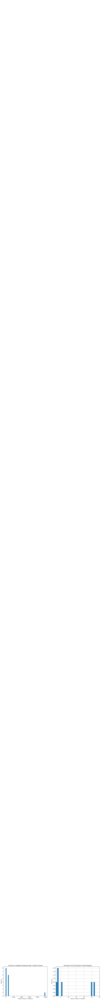

In [225]:
%pylab inline

fig, (ax1, ax2) = plt.subplots(1,2)
fig.set_size_inches(16,5)
ax1.hist(uv.unique_values, bins=50)
ax1.set_title('Amount of categorical features with X distinct values')
ax1.set_xlabel('Distinct values in a feature')
ax1.set_ylabel('Features')

ax2.set_xlim(2,30)
ax2.set_title('Zooming in the [0,30] part of left histogram')
ax2.set_xlabel('Distinct values in a feature')
ax2.set_ylabel('Features')
ax2.grid(True)
ax2.hist(uv[uv.unique_values <= 30].unique_values, bins=30)
ax2.annotate('Binary features', xy=(3, 71), xytext=(7, 71), arrowprops=dict(facecolor='black'))

In [128]:
#!pip install -q --upgrade ipython==5.5.0
#!pip install -q --upgrade ipykernel==4.10



In [129]:
#!python -m pip install tensorflow-gpu==1.15

#!wget https://developer.nvidia.com/compute/cuda/9.0/Prod/local_installers/cuda-repo-ubuntu1604-9-0-local_9.0.176-1_amd64-deb
#!dpkg -i cuda-repo-ubuntu1604-9-0-local_9.0.176-1_amd64-deb
#!apt-key add /var/cuda-repo-9-0-local/7fa2af80.pub
#!apt-get update
#!apt-get install cuda=9.0.176-1


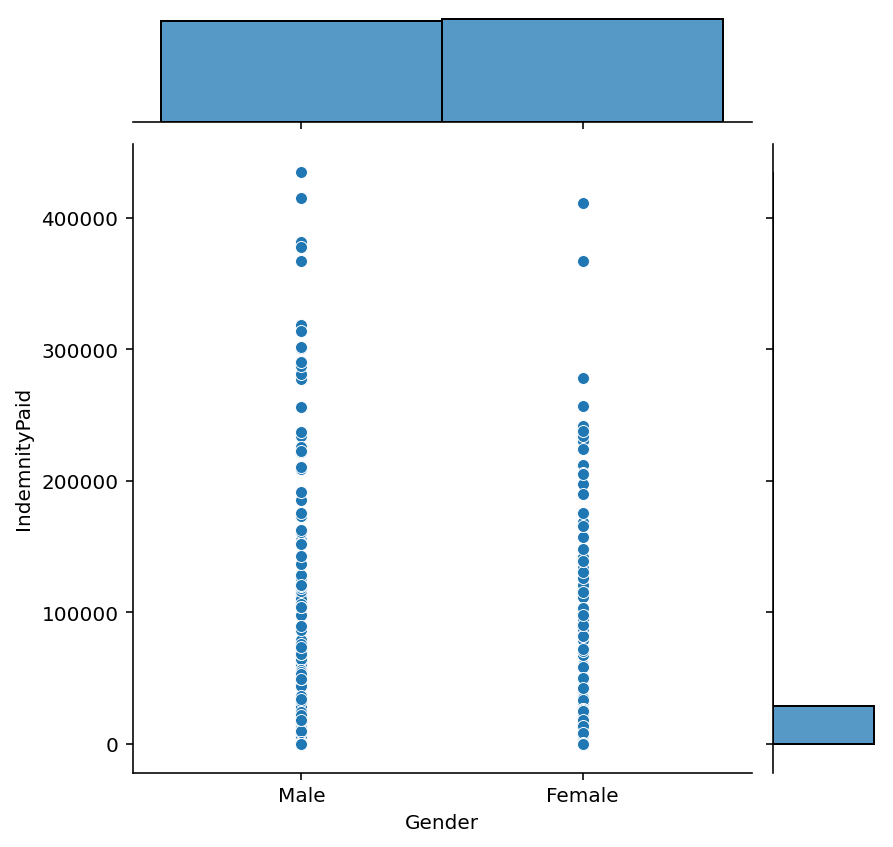

In [226]:
import seaborn as sns
sns.jointplot(x=df2["Gender"], y=df2["IndemnityPaid"], kind='scatter')

plt.show()

In [227]:
def f(x):
  dfd=x.copy()
  dfd['year']=pd.DatetimeIndex(x['IncidentDate']).year
  dfd['month']=pd.DatetimeIndex(x['IncidentDate']).month
  dfd['day']=pd.DatetimeIndex(x['IncidentDate']).day
  return dfd
df2=f(df2)

In [228]:
import datetime
years = df2['year']
months = df2['month']
days = df2['day']

dates = [str(int(year)) + '-' + str(int(month)) + '-' + str(int(day)) for year, month, day in zip(years, months,days)]
dates = [datetime.datetime.strptime(date, '%Y-%m-%d') for date in dates]
dates.sort()
print(dates)

[datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 1, 0, 0), datetime.datetime(1999, 7, 2, 0, 0), datetime.datetime(1999, 7, 2, 0, 0), datetime.datetime(1999, 7, 2, 0, 0), datetime.datetime(1999, 7, 2, 0, 0), 

In [133]:
#index = df2[df2['EmploymentStartDate'] == '#VALUE!'].index
#df2.drop(index, inplace=True)


In [234]:
df2["EmploymentStartDate"].value_counts()

#VALUE!       9967
1/1/1999         5
1/1/1995         3
1/1/2000         3
1/1/2001         2
1/1/1990         1
1/1/1980         1
11/1/2008        1
1/1/1972         1
2/12/1998        1
1/1/1997         1
5/1/1999         1
5/24/2004        1
5/16/2003        1
4/16/1990        1
1/16/2000        1
6/1/2006         1
12/16/1998       1
2/10/1996        1
8/13/2004        1
1/1/1998         1
8/3/1997         1
1/1/1992         1
5/22/2006        1
10/15/1992       1
Name: EmploymentStartDate, dtype: int64

In [235]:
#df2['ReturnToWorkDate'] = df2['ReturnToWorkDate'].replace(['mode'],'0.0')


In [236]:
pd.set_option('display.max_rows', None) 


In [237]:
df2['ReturnToWorkDate'].value_counts()

#VALUE!       8383
10/2/2000       15
12/29/1999      12
12/6/1999       10
5/1/2000        10
8/28/2000       10
7/18/2000        9
12/4/2000        8
1/10/2000        8
4/3/2000         8
8/16/1999        8
8/21/2000        7
3/20/2000        7
1/8/2001         7
2/26/2001        7
2/23/2000        7
11/19/1999       7
10/23/2000       7
6/13/2000        7
1/24/2000        7
2/12/2001        7
2/5/2001         7
6/26/2000        7
2/28/2000        7
4/4/2000         6
4/10/2000        6
4/17/2000        6
6/5/2000         6
11/9/2000        6
2/20/2001        6
8/24/2000        6
5/2/2000         6
7/17/2000        6
8/15/2000        6
1/22/2001        6
11/2/2000        6
11/28/2000       6
1/2/2001         6
5/15/2000        6
11/6/2000        6
9/6/2000         6
8/11/1999        5
9/23/1999        5
9/1/1999         5
12/11/2000       5
10/9/2000        5
12/8/2000        5
12/23/1999       5
6/7/2000         5
11/22/1999       5
9/5/2000         5
8/1/2000         5
4/17/2001   

In [238]:
df2['ReturnToWorkDate'] = df2['ReturnToWorkDate'].replace(['#VALUE!'],'1/1/1999')
df2['ReturnToWorkDate']

0        12/8/2009
1        6/26/2009
2        7/13/2009
3        6/12/2009
4         1/1/1999
5        6/25/2009
6         7/1/2009
7        6/27/2009
8         1/1/1999
9         1/1/1999
10        8/9/1999
11        1/1/1999
12        1/1/1999
13        1/1/1999
14        1/1/1999
15        1/1/1999
16        1/1/1999
17      11/30/1999
18        1/1/1999
19        1/1/1999
20        1/1/1999
21        1/1/1999
22        1/1/1999
23        1/1/1999
24        1/1/1999
25        1/1/1999
26        1/1/1999
27        1/1/1999
28        7/3/2000
29        1/1/1999
30        1/1/1999
31        1/1/1999
32        1/1/1999
33        1/1/1999
34        1/1/1999
35        1/1/1999
36        1/1/1999
37        7/3/1999
38        1/1/1999
39        1/1/1999
40        7/3/1999
41        1/1/1999
42        1/1/1999
43        1/1/1999
44        1/1/1999
45        1/1/1999
46        1/1/1999
47        1/1/1999
48        1/1/1999
49        1/1/1999
50        1/1/1999
51        9/9/1999
52        1/

In [239]:
def f(x):
  dfd=x.copy()
  dfd['year']=pd.DatetimeIndex(x['ReturnToWorkDate']).year
  dfd['month']=pd.DatetimeIndex(x['ReturnToWorkDate']).month
  dfd['day']=pd.DatetimeIndex(x['ReturnToWorkDate']).day
  return dfd
df2=f(df2)
import datetime
years = df2['year']
months = df2['month']
days = df2['day']

dates = [str(int(year)) + '-' + str(int(month)) + '-' + str(int(day)) for year, month, day in zip(years, months,days)]
dates = [datetime.datetime.strptime(date, '%Y-%m-%d') for date in dates]
dates.sort()
print(dates)

[datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), datetime.datetime(1999, 1, 1, 0, 0), 

In [240]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 24 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   TotalPaid_End             10000 non-null  float64
 1   TotalReserves_End         10000 non-null  float64
 2   TotalRecovery_End         10000 non-null  float64
 3   IndemnityPaid             10000 non-null  float64
 4   OtherPaid                 10000 non-null  float64
 5   ClaimantStatus_End        10000 non-null  object 
 6   IncidentDate              10000 non-null  object 
 7   IncidentDescription       10000 non-null  object 
 8   EmploymentStartDate       10000 non-null  object 
 9   ReturnToWorkDate          10000 non-null  object 
 10  ClaimOpenedDate           10000 non-null  object 
 11  ClaimClosedDate           10000 non-null  object 
 12  EmployerNotificationDate  10000 non-null  object 
 13  ClaimReceivedDate         10000 non-null  object 
 14  IsDenie

In [241]:
df2["ClaimOpenedDate"].value_counts()

10/4/1999     63
6/22/2000     62
4/27/2000     58
2/8/2000      58
5/19/2000     57
4/6/2000      55
3/21/2000     51
8/12/1999     50
11/11/1999    50
8/24/2000     48
1/2/2001      47
2/11/2000     47
2/9/2000      47
5/11/2000     47
11/21/2000    46
9/18/2000     46
7/26/2000     46
6/6/2000      45
8/25/2000     45
1/26/2001     45
1/18/2001     44
2/25/2000     44
7/10/2000     44
8/24/1999     44
5/31/2000     44
9/22/1999     44
7/19/2000     43
12/20/2000    43
11/2/2000     43
9/1/1999      43
6/29/2000     42
12/13/2000    42
2/14/2001     42
4/18/2000     41
11/16/2000    41
2/17/2000     40
8/29/2000     40
10/19/1999    40
12/6/1999     40
12/13/1999    39
12/7/1999     39
3/22/2000     39
3/28/2000     39
7/25/2000     38
8/14/2000     38
12/6/2000     38
6/1/2000      38
8/20/1999     37
7/7/2000      37
3/7/2000      37
12/30/1999    37
11/6/2000     37
12/19/2000    35
8/4/2000      35
2/7/2000      35
6/30/2000     35
9/27/2000     35
10/18/2000    35
2/22/2000     

In [242]:
def f(x):
  dfd=x.copy()
  dfd['year1']=pd.DatetimeIndex(x['ClaimOpenedDate']).year
  dfd['month1']=pd.DatetimeIndex(x['ClaimOpenedDate']).month
  dfd['day1']=pd.DatetimeIndex(x['ClaimOpenedDate']).day
  return dfd
df2=f(df2)
import datetime
years = df2['year1']
months = df2['month1']
days = df2['day1']

dates = [str(int(year1)) + '-' + str(int(month1)) + '-' + str(int(day1)) for year1, month1, day1 in zip(years, months,days)]
dates = [datetime.datetime.strptime(date, '%Y-%m-%d') for date in dates]
dates.sort()
print(dates)

[datetime.datetime(1999, 7, 7, 0, 0), datetime.datetime(1999, 7, 8, 0, 0), datetime.datetime(1999, 7, 8, 0, 0), datetime.datetime(1999, 7, 8, 0, 0), datetime.datetime(1999, 7, 8, 0, 0), datetime.datetime(1999, 7, 9, 0, 0), datetime.datetime(1999, 7, 9, 0, 0), datetime.datetime(1999, 7, 9, 0, 0), datetime.datetime(1999, 7, 12, 0, 0), datetime.datetime(1999, 7, 12, 0, 0), datetime.datetime(1999, 7, 12, 0, 0), datetime.datetime(1999, 7, 12, 0, 0), datetime.datetime(1999, 7, 12, 0, 0), datetime.datetime(1999, 7, 12, 0, 0), datetime.datetime(1999, 7, 12, 0, 0), datetime.datetime(1999, 7, 12, 0, 0), datetime.datetime(1999, 7, 12, 0, 0), datetime.datetime(1999, 7, 12, 0, 0), datetime.datetime(1999, 7, 12, 0, 0), datetime.datetime(1999, 7, 12, 0, 0), datetime.datetime(1999, 7, 13, 0, 0), datetime.datetime(1999, 7, 13, 0, 0), datetime.datetime(1999, 7, 13, 0, 0), datetime.datetime(1999, 7, 13, 0, 0), datetime.datetime(1999, 7, 13, 0, 0), datetime.datetime(1999, 7, 14, 0, 0), datetime.datetime(1

In [243]:
df2['ClaimClosedDate'].value_counts()

3/31/2005     8303
#VALUE!         40
10/18/2007      15
9/8/2006         8
7/18/2007        8
9/8/2005         8
7/15/2005        8
8/11/2006        7
3/21/2007        7
5/13/2008        7
6/1/2006         7
5/17/2006        7
3/23/2007        7
8/28/2006        7
11/10/2008       6
6/27/2005        6
8/13/2008        6
11/12/2008       6
5/27/2005        6
3/22/2006        6
6/25/2007        6
2/2/2007         6
4/5/2007         6
10/11/2005       6
10/21/2008       6
7/11/2007        6
5/19/2008        6
12/12/2006       5
11/22/2005       5
4/8/2005         5
4/29/2005        5
8/21/2008        5
8/1/2008         5
7/5/2006         5
10/25/2005       5
3/5/2007         5
6/20/2005        5
9/24/2007        5
10/3/2007        5
7/19/2006        5
3/21/2006        5
4/4/2005         5
6/23/2006        5
7/13/2007        5
9/26/2006        5
11/29/2007       5
8/8/2008         5
3/8/2006         5
3/9/2006         5
2/10/2009        5
6/26/2006        5
6/7/2007         5
2/28/2008   

In [244]:
df2['ClaimClosedDate'] = df2['ClaimClosedDate'].replace(['#VALUE!'],'3/31/2005')
df2['ClaimClosedDate']

0        7/20/2010
1       11/25/2009
2        3/30/2010
3        3/29/2010
4         5/6/2011
5       11/25/2009
6       11/25/2009
7        2/22/2010
8        3/31/2005
9        3/31/2005
10       3/31/2005
11       3/31/2005
12       3/31/2005
13       3/31/2005
14       3/31/2005
15       3/31/2005
16       3/31/2005
17       3/31/2005
18       3/31/2005
19       3/31/2005
20       3/31/2005
21       3/31/2005
22       3/31/2005
23       3/31/2005
24       9/14/2006
25       3/31/2005
26       3/31/2005
27       3/31/2005
28        2/2/2006
29       3/31/2005
30      12/22/2005
31       3/31/2005
32       3/31/2005
33       3/31/2005
34       3/31/2005
35       3/31/2005
36       3/31/2005
37       3/31/2005
38       3/31/2005
39       3/31/2005
40       3/31/2005
41       3/31/2005
42       3/31/2005
43       3/31/2005
44       3/31/2005
45       6/17/2008
46       3/31/2005
47       3/31/2005
48       3/31/2005
49       3/31/2005
50       3/31/2005
51        4/9/2007
52       7/1

In [245]:
def f(x):
  dfd=x.copy()
  dfd['year2']=pd.DatetimeIndex(x['ClaimClosedDate']).year
  dfd['month2']=pd.DatetimeIndex(x['ClaimClosedDate']).month
  dfd['day2']=pd.DatetimeIndex(x['ClaimClosedDate']).day
  return dfd
df2=f(df2)
import datetime
years = df2['year2']
months = df2['month2']
days = df2['day2']

dates = [str(int(year2)) + '-' + str(int(month2)) + '-' + str(int(day2)) for year2, month2, day2 in zip(years, months,days)]
dates = [datetime.datetime.strptime(date, '%Y-%m-%d') for date in dates]
dates.sort()
print(dates)

[datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.datetime(2005, 3, 31, 0, 0), datetime.da

In [246]:
df2['EmployerNotificationDate'].max()

'9/9/2000'

In [247]:

df2['EmployerNotificationDate'].min()

'1/1/2000'

In [248]:
pd.Timestamp.max

Timestamp('2262-04-11 23:47:16.854775807')

In [249]:
pd.Timestamp.min

Timestamp('1677-09-21 00:12:43.145225')

In [250]:
df2['EmployerNotificationDate'].value_counts()

7/28/1999     68
1/26/2000     48
1/31/2000     43
2/1/2000      42
8/1/2000      39
1/24/2000     37
7/17/2000     35
7/24/2000     35
7/31/2000     35
8/16/2000     35
7/19/2000     35
6/8/2000      34
1/16/2001     34
2/2/2000      34
5/16/2000     33
6/27/2000     33
2/1/2001      33
3/13/2000     33
11/9/1999     32
10/25/2000    32
11/14/2000    31
10/31/2000    31
9/27/1999     31
9/20/1999     30
7/26/1999     30
11/6/2000     30
7/6/2000      29
11/29/2000    29
2/15/2000     29
1/24/2001     29
7/12/2000     29
11/18/1999    29
10/4/1999     29
2/3/2000      29
3/8/2000      29
6/26/2000     29
7/7/2000      28
8/19/1999     28
1/9/2001      28
8/23/2000     28
7/8/1999      28
3/23/2000     28
8/10/2000     28
7/20/2000     28
8/7/2000      28
9/27/2000     28
10/11/1999    28
9/8/1999      28
7/18/2000     28
12/16/1999    28
5/22/2000     28
8/24/2000     27
3/21/2000     27
6/28/2000     27
8/26/1999     27
11/13/2000    27
6/13/2000     27
8/3/2000      27
1/27/2000     

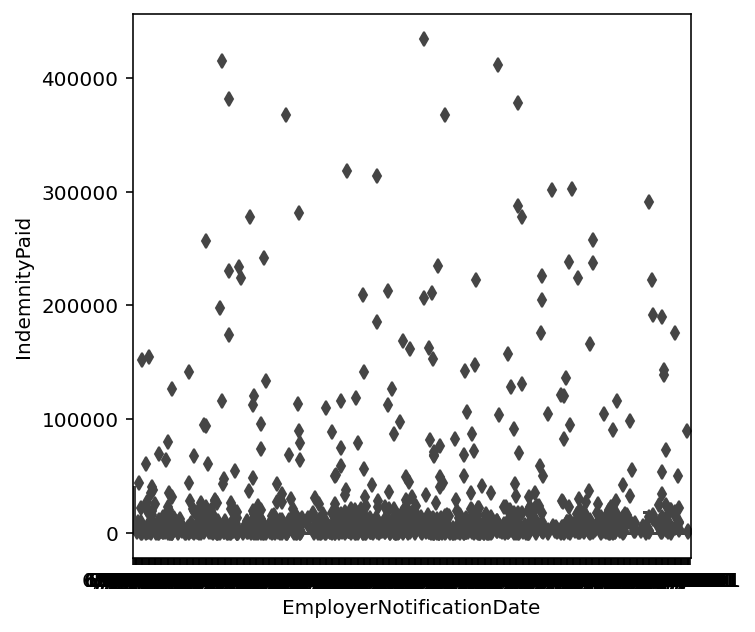

In [251]:
plt.figure(figsize = (5, 5))
sns.boxplot(x = 'EmployerNotificationDate', y = 'IndemnityPaid',  data = df2)


In [252]:
def f(x):
  dfd=x.copy()
  dfd1['year']=pd.DatetimeIndex(x['EmployerNotificationDate']).year
  dfd1['month']=pd.DatetimeIndex(x['EmployerNotificationDate']).month
  dfd1['day']=pd.DatetimeIndex(x['EmployerNotificationDate']).day
  return dfd1
df2=f(df2)
import datetime
years = df2['year']
months = df2['month']
days = df2['day']

dates = [str(int(year)) + '-' + str(int(month)) + '-' + str(int(day)) for year, month, day in zip(years, months,days)]
dates = [datetime.datetime.strptime(date, '%Y-%m-%d') for date in dates]
dates.sort()
print(dates)


OutOfBoundsDatetime: ignored

In [253]:
df2["ClaimReceivedDate"].value_counts()

10/4/1999     64
4/27/2000     58
7/7/2000      57
2/8/2000      56
12/6/2000     55
3/20/2000     54
5/19/2000     53
2/21/2000     52
6/22/2000     52
11/21/2000    48
11/11/1999    48
8/12/1999     48
6/6/2000      48
1/2/2001      47
12/19/2000    47
2/11/2000     46
9/22/1999     46
7/26/2000     46
5/11/2000     45
8/14/2000     45
4/6/2000      45
2/9/2000      43
2/25/2000     43
5/30/2000     43
1/18/2001     42
1/23/2001     42
2/14/2001     42
8/23/2000     42
1/26/2001     42
8/24/2000     41
7/10/2000     41
12/6/1999     41
12/7/1999     41
2/7/2000      41
8/29/2000     41
7/19/2000     39
7/25/2000     39
7/13/2000     39
6/29/2000     39
11/16/2000    39
3/28/2000     38
4/10/2000     37
10/11/2000    37
12/30/1999    36
8/18/2000     36
3/22/2000     36
8/25/2000     36
3/7/2000      36
10/18/2000    34
9/3/1999      34
2/24/2000     34
11/2/2000     34
1/7/2000      34
2/28/2000     34
5/2/2000      34
11/6/2000     34
9/15/2000     34
12/12/2000    34
12/13/2000    

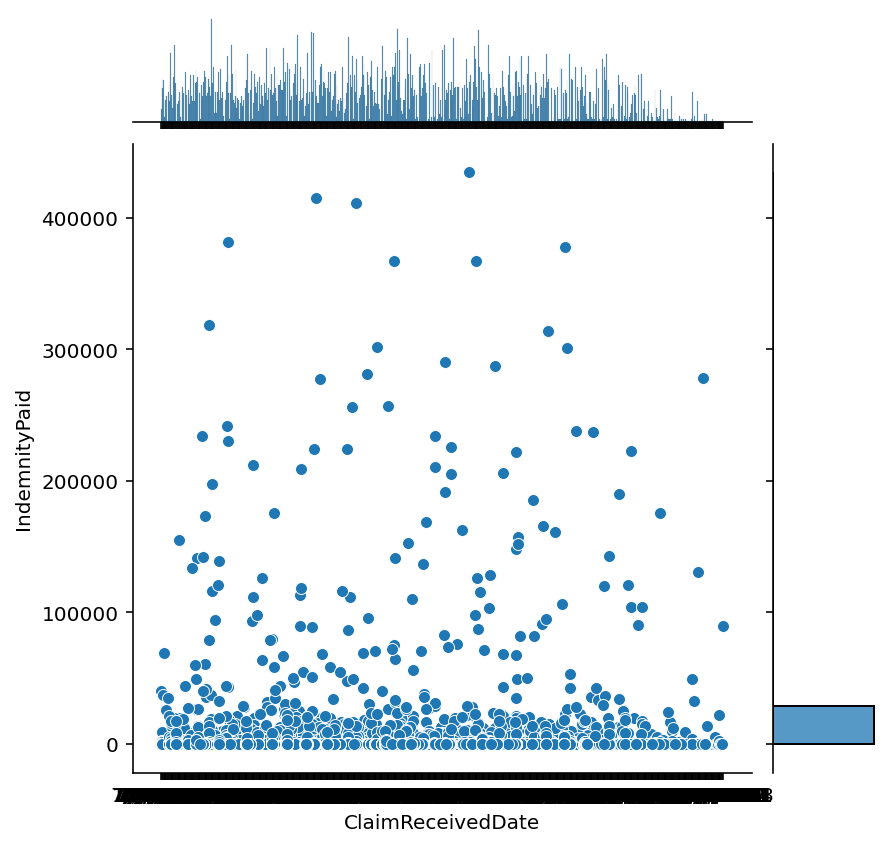

In [254]:
sns.jointplot(x=df2["ClaimReceivedDate"], y=df2["IndemnityPaid"], kind='scatter')

plt.show()

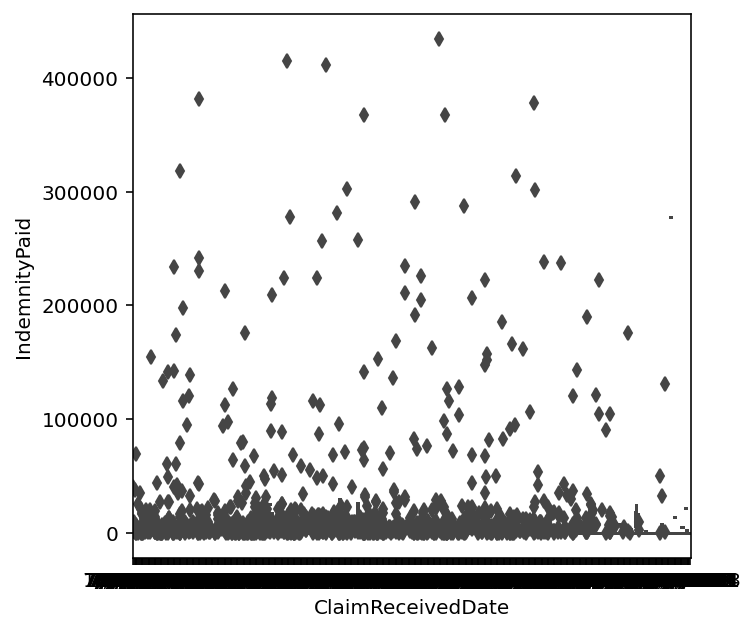

In [255]:
plt.figure(figsize = (5, 5))
sns.boxplot(x = 'ClaimReceivedDate', y = 'IndemnityPaid',  data = df2)

In [256]:
def f(x):
  dfd=x.copy()
  dfd['year']=pd.DatetimeIndex(x['ClaimReceivedDate']).year
  dfd['month']=pd.DatetimeIndex(x['ClaimReceivedDate']).month
  dfd['day']=pd.DatetimeIndex(x['ClaimReceivedDate']).day
  return dfd
df2=f(df2)
import datetime
years = df2['year']
months = df2['month']
days = df2['day']

dates = [str(int(year)) + '-' + str(int(month)) + '-' + str(int(day)) for year, month, day in zip(years, months,days)]
dates = [datetime.datetime.strptime(date, '%Y-%m-%d') for date in dates]
dates.sort()
print(dates)

OutOfBoundsDatetime: ignored

In [257]:
df2=df2.drop(["EmployerNotificationDate"],axis=1)
df2=df2.drop(["ClaimReceivedDate"],axis=1)

In [258]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 28 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   TotalPaid_End        10000 non-null  float64
 1   TotalReserves_End    10000 non-null  float64
 2   TotalRecovery_End    10000 non-null  float64
 3   IndemnityPaid        10000 non-null  float64
 4   OtherPaid            10000 non-null  float64
 5   ClaimantStatus_End   10000 non-null  object 
 6   IncidentDate         10000 non-null  object 
 7   IncidentDescription  10000 non-null  object 
 8   EmploymentStartDate  10000 non-null  object 
 9   ReturnToWorkDate     10000 non-null  object 
 10  ClaimOpenedDate      10000 non-null  object 
 11  ClaimClosedDate      10000 non-null  object 
 12  IsDenied             10000 non-null  int64  
 13  Gender               10000 non-null  object 
 14  ClaimantType         10000 non-null  object 
 15  InjuryCause          10000 non-null  

In [259]:
df2=df2.drop(["ReturnToWorkDate"],axis=1)

In [260]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 27 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   TotalPaid_End        10000 non-null  float64
 1   TotalReserves_End    10000 non-null  float64
 2   TotalRecovery_End    10000 non-null  float64
 3   IndemnityPaid        10000 non-null  float64
 4   OtherPaid            10000 non-null  float64
 5   ClaimantStatus_End   10000 non-null  object 
 6   IncidentDate         10000 non-null  object 
 7   IncidentDescription  10000 non-null  object 
 8   EmploymentStartDate  10000 non-null  object 
 9   ClaimOpenedDate      10000 non-null  object 
 10  ClaimClosedDate      10000 non-null  object 
 11  IsDenied             10000 non-null  int64  
 12  Gender               10000 non-null  object 
 13  ClaimantType         10000 non-null  object 
 14  InjuryCause          10000 non-null  object 
 15  InjuryNature         10000 non-null  

In [261]:
import collections

cat_features = list(df2.select_dtypes(include=['object']).columns)
print("categorical values: {}".format(len(cat_features)))

cat_uniques = []
for cat in cat_features:
    cat_uniques.append(len(df2[cat].unique()))

uv = pd.DataFrame.from_dict(collections.OrderedDict([('cat_names', cat_features), ('unique_values', cat_uniques)]))
uv

categorical values: 12


,cat_names,unique_values
0,ClaimantStatus_End,3
1,IncidentDate,607
2,IncidentDescription,9917
3,EmploymentStartDate,25
4,ClaimOpenedDate,638
5,ClaimClosedDate,772
6,Gender,2
7,ClaimantType,3
8,InjuryCause,27
9,InjuryNature,38


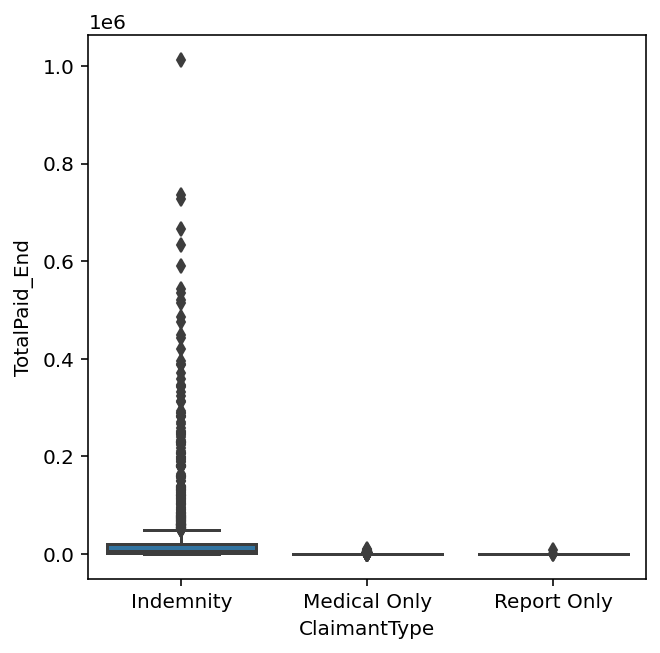

In [262]:
plt.figure(figsize = (5, 5))
sns.boxplot(x = 'ClaimantType', y = 'TotalPaid_End',  data = df2)


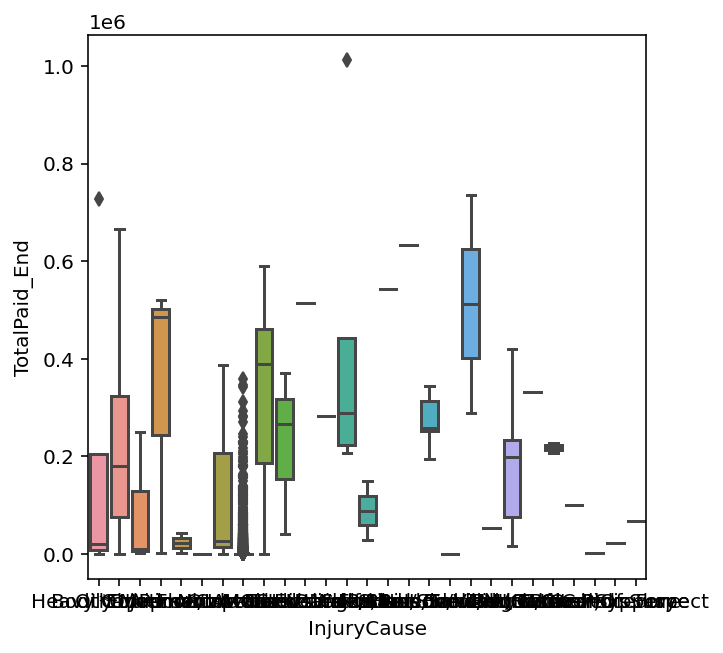

In [263]:
plt.figure(figsize = (5, 5))
sns.boxplot(x = 'InjuryCause', y = 'TotalPaid_End',  data = df2)


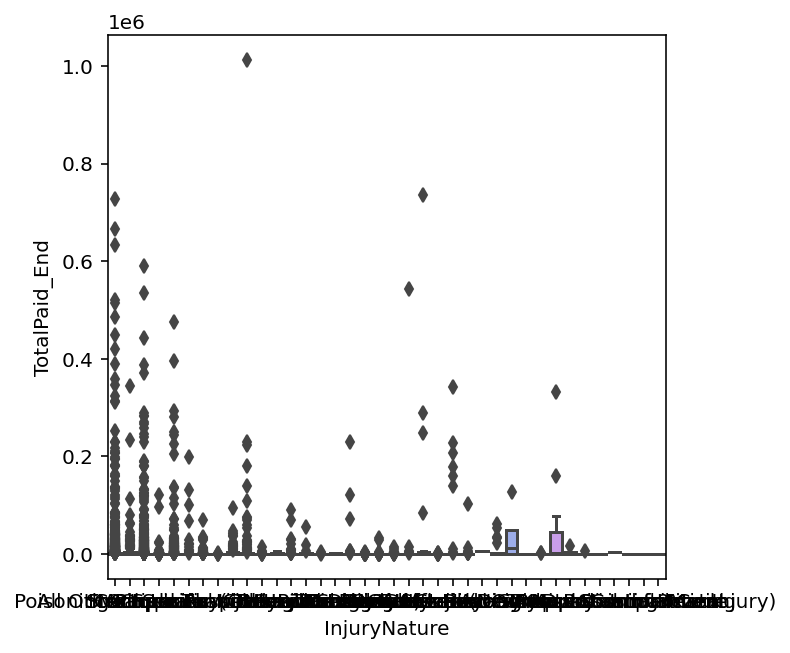

In [264]:
plt.figure(figsize = (5, 5))
sns.boxplot(x = 'InjuryNature', y = 'TotalPaid_End',  data = df2)


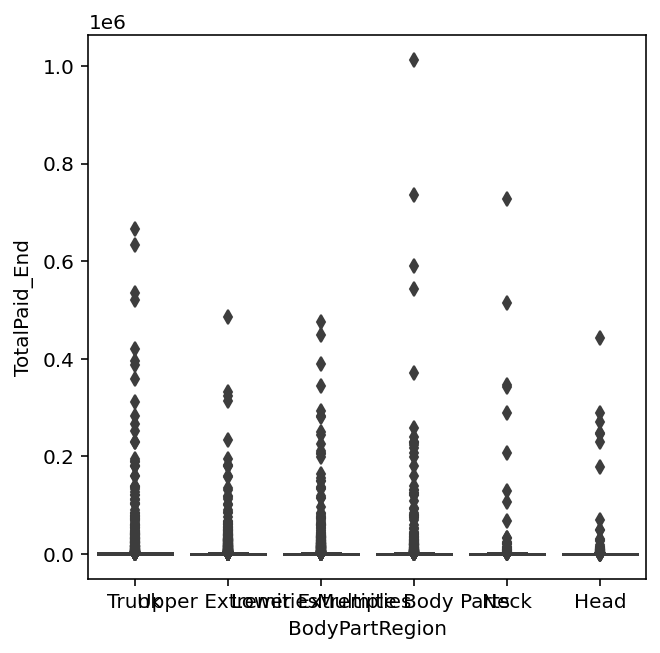

In [265]:
plt.figure(figsize = (5, 5))
sns.boxplot(x = 'BodyPartRegion', y = 'TotalPaid_End',  data = df2)


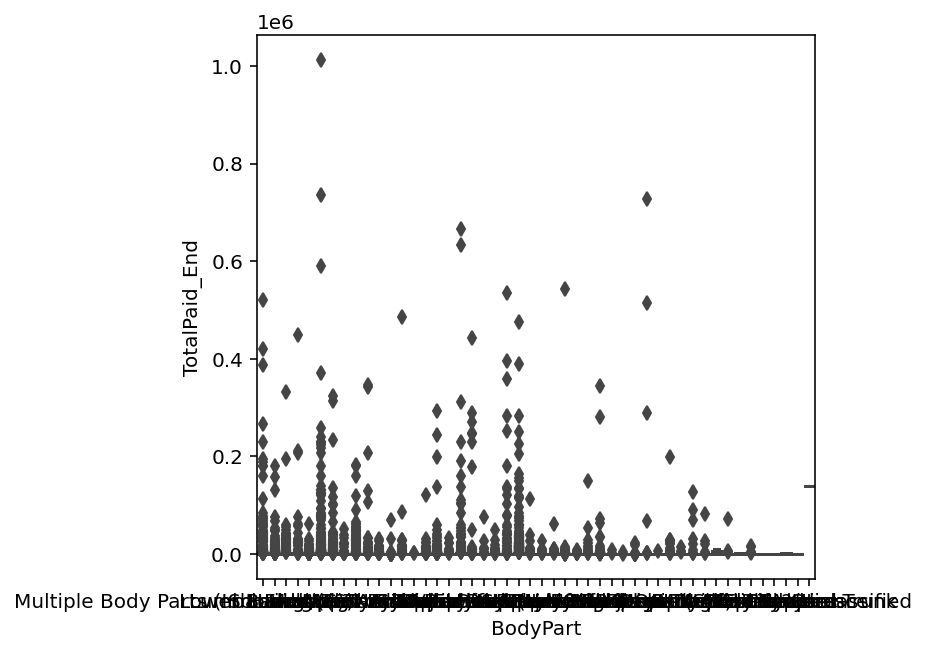

In [266]:
plt.figure(figsize = (5, 5))
sns.boxplot(x = 'BodyPart', y = 'TotalPaid_End',  data = df2)


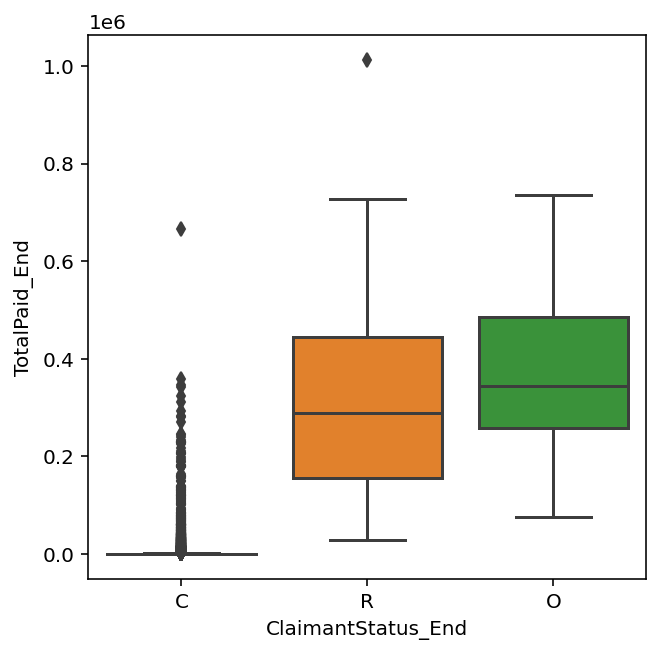

In [267]:
plt.figure(figsize = (5, 5))
sns.boxplot(x = 'ClaimantStatus_End', y = 'TotalPaid_End',  data = df2)


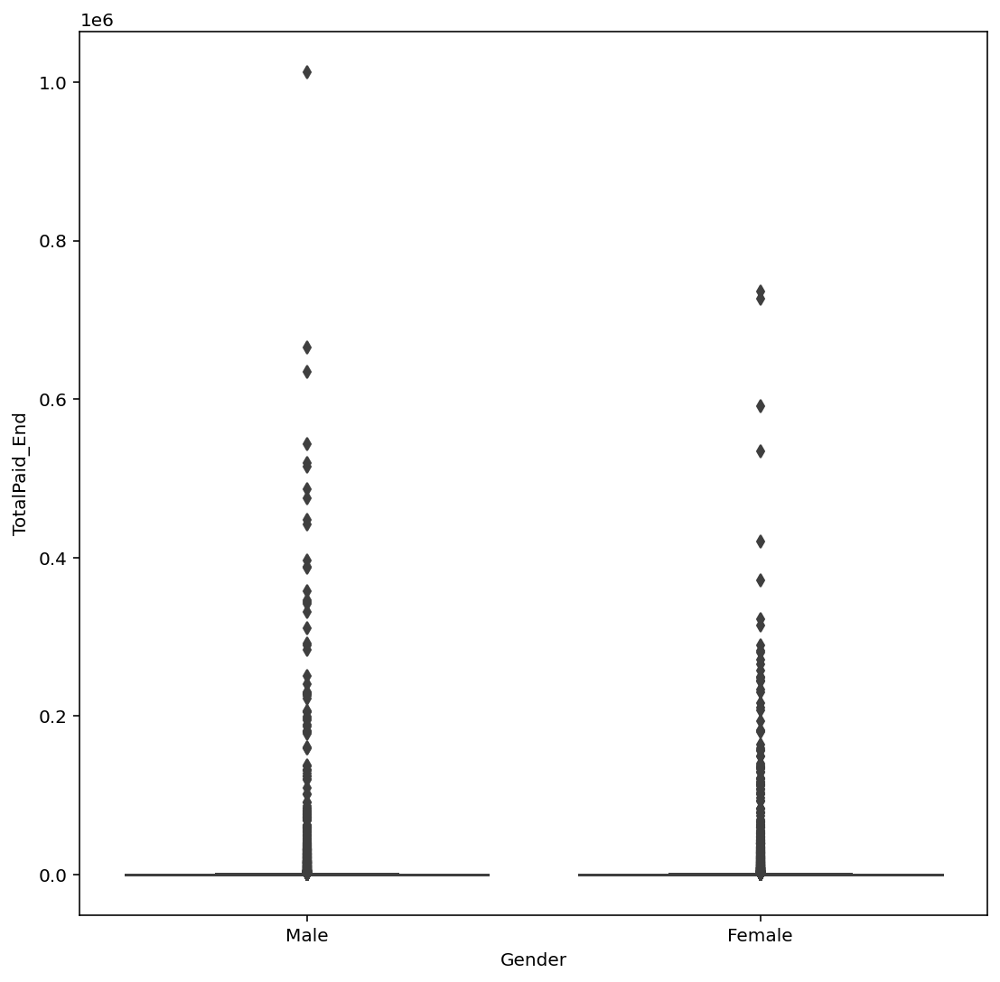

In [268]:
plt.figure(figsize = (9, 9))
sns.boxplot(x = 'Gender', y = 'TotalPaid_End',  data = df2)


In [269]:
from sklearn.preprocessing import LabelEncoder
lb_make = LabelEncoder()

df2["ClaimantStatus_End code"] = lb_make.fit_transform(df2["ClaimantStatus_End"])
df2.append(df2["ClaimantStatus_End code"])
df2["Gender code"] = lb_make.fit_transform(df2["Gender"])
df2.append(df2["Gender code"])
df2.head(3)


,TotalPaid_End,TotalReserves_End,TotalRecovery_End,IndemnityPaid,OtherPaid,ClaimantStatus_End,IncidentDate,IncidentDescription,EmploymentStartDate,ClaimOpenedDate,ClaimClosedDate,IsDenied,Gender,ClaimantType,InjuryCause,InjuryNature,BodyPartRegion,BodyPart,year,month,day,year1,month1,day1,year2,month2,day2,ClaimantStatus_End code,Gender code
0,11947.55,0.0,0.0,243.65,11703.90,C,6/17/2009,Employee was moving concrete rings and installing a meter. He strained lower back.,5/24/2004,7/2/2009,7/20/2010,0,Male,Indemnity,Heavy Object,Strain,Trunk,Lower Back Area,2009,12,8,2009,7,2,2010,7,20,0,1
1,0.00,0.0,0.0,0.00,0.00,C,6/26/2009,Employee was pulling lining. He felt a pop in the back causing a strain.,8/13/2004,7/2/2009,11/25/2009,0,Male,Medical Only,Bodily Motion,Strain,Trunk,Lower Back Area,2009,6,26,2009,7,2,2009,11,25,0,1
2,9295.89,0.0,0.0,0.00,9295.89,C,6/25/2009,Employee was in the restroom. He heard a scream from another restroom that startled him and he fell on his left hand causing a fracture. (),4/16/1990,7/2/2009,3/30/2010,0,Male,Indemnity,Other Person,Fracture,Upper Extremities,Hand,2009,7,13,2009,7,2,2010,3,30,0,1


In [270]:
df2["Gender code"].value_counts()


0    5039
1    4961
Name: Gender code, dtype: int64

In [271]:
df2["InjuryCause"].value_counts()

Not Available               9933
*Captured Data                11
Ground (Outdoor)               5
Bodily Motion                  5
Patient Handling               5
Motor Vehicles, Licensed       5
Heavy Object                   4
Stairs                         3
Equipment                      3
*Other - Code Not Listed       3
Other Person                   3
N.O.C.                         2
Fluids                         2
Floor                          2
Person/Violet/Com              2
Method Or Procedure            1
Phys Force                     1
Bench/Chair                    1
Control Of Suspect             1
Walk/Path/Sidewalk             1
Surface-Slippery               1
Other Unsafe Act               1
Chemicals/Solvent,Gasses       1
Hand Tools/Non Powered         1
Att-To Footings/Sur            1
Stress                         1
Animal/Insects                 1
Name: InjuryCause, dtype: int64

In [272]:
df2=df2.drop(["InjuryCause"],axis=1)

In [273]:
df2["InjuryNature"].value_counts()

Strain                                             3031
Contusion                                          2935
Sprain                                              900
Laceration                                          639
Puncture                                            633
Foreign Body                                        281
Fracture                                            205
No Physical Injury                                  203
Dermatitis                                          154
Multiple Physical Injuries Only                     146
Carpal Tunnel Syndrome                              121
Respiratory Disorders                               116
Burn                                                105
All Other Specific Injuries, Noc                     81
Crushing                                             76
Infection                                            59
Severance                                            43
Inflammation                                    

In [274]:
df2["BodyPart"].value_counts()

Multiple Body Parts (Including Body Systems and Body Parts)    967
Lower Back Area                                                826
Knee                                                           817
Finger(S)                                                      726
Hand                                                           637
Ankle                                                          516
Wrist                                                          451
Eyes                                                           437
Upper Arm                                                      385
Foot                                                           332
Shoulder(S)                                                    325
Multiple Head Injury                                           313
Disc-Trunk                                                     306
Thumb                                                          261
Lumbar and/or Sacral Vertebrae (Vertebra NOC Trunk)           

In [275]:
df2["BodyPartRegion"].value_counts()

Upper Extremities      3206
Lower Extremities      2197
Trunk                  1857
Multiple Body Parts    1394
Head                   1039
Neck                    307
Name: BodyPartRegion, dtype: int64

In [276]:
from sklearn.preprocessing import LabelBinarizer

lb_style = LabelBinarizer()
lb_results = lb_style.fit_transform(df2["BodyPartRegion"])
lb_results

array([[0, 0, 0, 0, 1, 0],
       [0, 0, 0, 0, 1, 0],
       [0, 0, 0, 0, 0, 1],
       ...,
       [0, 0, 0, 0, 1, 0],
       [0, 0, 1, 0, 0, 0],
       [0, 0, 1, 0, 0, 0]])

In [277]:
df2 = pd.get_dummies(data=df2, columns=["BodyPartRegion"])


In [278]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 33 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   TotalPaid_End                       10000 non-null  float64
 1   TotalReserves_End                   10000 non-null  float64
 2   TotalRecovery_End                   10000 non-null  float64
 3   IndemnityPaid                       10000 non-null  float64
 4   OtherPaid                           10000 non-null  float64
 5   ClaimantStatus_End                  10000 non-null  object 
 6   IncidentDate                        10000 non-null  object 
 7   IncidentDescription                 10000 non-null  object 
 8   EmploymentStartDate                 10000 non-null  object 
 9   ClaimOpenedDate                     10000 non-null  object 
 10  ClaimClosedDate                     10000 non-null  object 
 11  IsDenied                            10000 

In [279]:
df2["ClaimantType code"] = lb_make.fit_transform(df2["ClaimantType"])
df2.append(df2["ClaimantType code"])
df2["InjuryNature code"] = lb_make.fit_transform(df2["InjuryNature"])
df2.append(df2["InjuryNature code"])
df2.head(5)
df2["BodyPart code"] = lb_make.fit_transform(df2["BodyPart"])
df2.append(df2["BodyPart code"])
df2["IncidentDescription code"] = lb_make.fit_transform(df2["IncidentDescription"])
df2.append(df2["IncidentDescription code"])
df2.head(5)

,TotalPaid_End,TotalReserves_End,TotalRecovery_End,IndemnityPaid,OtherPaid,ClaimantStatus_End,IncidentDate,IncidentDescription,EmploymentStartDate,ClaimOpenedDate,ClaimClosedDate,IsDenied,Gender,ClaimantType,InjuryNature,BodyPart,year,month,day,year1,month1,day1,year2,month2,day2,ClaimantStatus_End code,Gender code,BodyPartRegion_Head,BodyPartRegion_Lower Extremities,BodyPartRegion_Multiple Body Parts,BodyPartRegion_Neck,BodyPartRegion_Trunk,BodyPartRegion_Upper Extremities,ClaimantType code,InjuryNature code,BodyPart code,IncidentDescription code
0,11947.55,0.0,0.0,243.65,11703.90,C,6/17/2009,Employee was moving concrete rings and installing a meter. He strained lower back.,5/24/2004,7/2/2009,7/20/2010,0,Male,Indemnity,Strain,Lower Back Area,2009,12,8,2009,7,2,2010,7,20,0,1,0,0,0,0,1,0,0,36,21,8946
1,0.00,0.0,0.0,0.00,0.00,C,6/26/2009,Employee was pulling lining. He felt a pop in the back causing a strain.,8/13/2004,7/2/2009,11/25/2009,0,Male,Medical Only,Strain,Lower Back Area,2009,6,26,2009,7,2,2009,11,25,0,1,0,0,0,0,1,0,1,36,21,8948
2,9295.89,0.0,0.0,0.00,9295.89,C,6/25/2009,Employee was in the restroom. He heard a scream from another restroom that startled him and he fell on his left hand causing a fracture. (),4/16/1990,7/2/2009,3/30/2010,0,Male,Indemnity,Fracture,Hand,2009,7,13,2009,7,2,2010,3,30,0,1,0,0,0,0,0,1,0,14,14,8944
3,1026.29,0.0,0.0,0.00,1026.29,C,6/12/2009,"Employee was unloading truck using a pallet jack to unload heavy equipment. Heavy load caused him to lose balance, and he struck his right shoulder on door jamb causing unspecified injury. ()",5/22/2006,7/2/2009,3/29/2010,0,Male,Medical Only,Contusion,Shoulder(S),2009,6,12,2009,7,2,2010,3,29,0,1,0,0,0,0,0,1,1,8,36,8949
4,43108.03,0.0,0.0,40000.00,3108.03,C,6/29/2009,Employee was leaning over to pick up a piece of paper. She fell out of rolling chair causing pain to lower back. Dx: lower back strain/buldging disc. (),5/16/2003,7/2/2009,5/6/2011,0,Female,Indemnity,Strain,Lower Back Area,1999,1,1,2009,7,2,2011,5,6,0,0,0,0,0,0,1,0,0,36,21,8945


In [280]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 37 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   TotalPaid_End                       10000 non-null  float64
 1   TotalReserves_End                   10000 non-null  float64
 2   TotalRecovery_End                   10000 non-null  float64
 3   IndemnityPaid                       10000 non-null  float64
 4   OtherPaid                           10000 non-null  float64
 5   ClaimantStatus_End                  10000 non-null  object 
 6   IncidentDate                        10000 non-null  object 
 7   IncidentDescription                 10000 non-null  object 
 8   EmploymentStartDate                 10000 non-null  object 
 9   ClaimOpenedDate                     10000 non-null  object 
 10  ClaimClosedDate                     10000 non-null  object 
 11  IsDenied                            10000 

In [281]:
df2=df2.drop(["ClaimantStatus_End","IncidentDate","IncidentDescription","EmploymentStartDate","ClaimOpenedDate","ClaimClosedDate","Gender","ClaimantType","InjuryNature","BodyPart"],axis=1)

Continuous: 21 features


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fd0f3b5b610>,
      dtype=object)

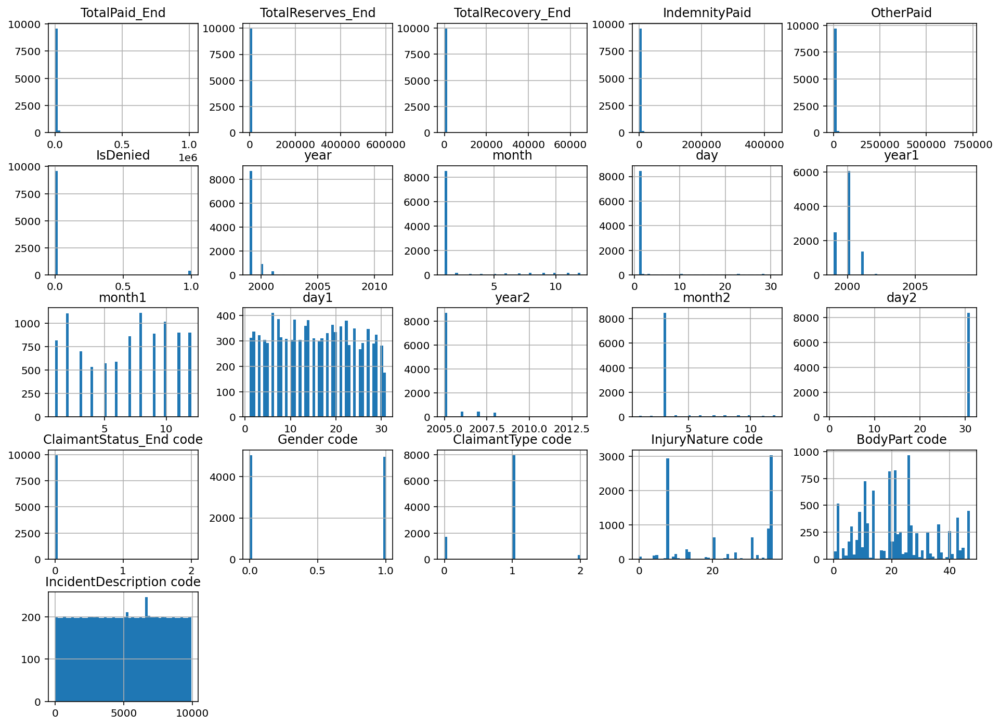

In [282]:
cont_features = [cont for cont in list(df2.select_dtypes(
                 include=['float64', 'int64']).columns)]
print("Continuous: {} features".format(len(cont_features)))
df2[cont_features].hist(bins=50, figsize=(16,12))


In [283]:
df2["TotalPaid_End"].value_counts()

 0.00          1796
 51.16           40
 66.68           37
 61.35           35
 6.50            24
 100.00          23
 50.01           22
 36.21           19
 32.59           16
 56.68           16
 91.97           15
 30.00           14
 68.98           13
 82.77           12
 78.17           12
 84.61           12
 86.22           12
 46.04           12
 6.25            11
 47.07           11
 43.49           11
 71.40           10
 86.64           10
 60.01           10
 9.00            10
 41.40            9
 10.00            9
 49.11            8
 111.49           8
 64.01            8
 88.29            8
 55.00            8
 60.00            7
 20.00            7
 75.00            7
 65.00            7
 12.50            7
 80.00            7
 81.85            6
 121.66           6
 128.18           6
 78.50            6
 6.75             6
 252.47           6
 87.37            6
 41.00            6
 38.37            6
 8.27             5
 131.68           5
 175.00           5


In [284]:
df2["IndemnityPaid"].value_counts()

0.00         8842
20000.00        6
5000.00         6
10000.00        5
600.00          5
7500.00         4
2500.00         3
25000.00        3
17640.00        3
2000.00         3
210.00          3
3100.00         2
28000.00        2
4500.00         2
725.12          2
3000.00         2
35000.00        2
40000.00        2
6720.00         2
15000.00        2
6769.20         2
22500.00        2
420.00          2
16000.00        2
8820.00         2
5292.00         2
17808.00        2
4000.00         2
32.74           2
252.00          2
16894.50        2
336.00          2
67392.00        1
8087.04         1
196.20          1
515.63          1
392.74          1
34253.80        1
9681.86         1
6790.65         1
5372.20         1
393.22          1
9152.85         1
12455.94        1
13958.28        1
1537.35         1
5038.74         1
60.53           1
26645.35        1
2172.96         1
3765.84         1
439.16          1
737.00          1
8580.03         1
18856.72        1
22772.92  

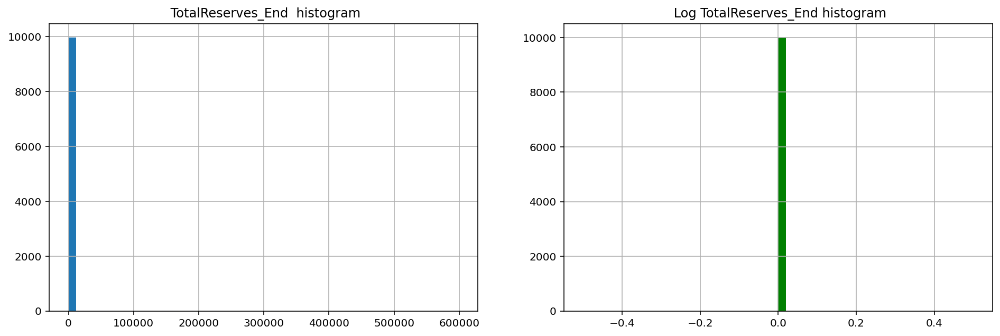

In [285]:
fig, (ax1,ax2) = plt.subplots(1,2)
fig.set_size_inches(16,5)
ax1.hist(df2['TotalReserves_End'], bins=50)
ax1.set_title(' TotalReserves_End  histogram')
ax1.grid(True)
#ax2.hist(df[np.isfinite(df['distance'])].values)

ax2.hist(np.log(np.isfinite(df2['TotalReserves_End'])), bins=50, color='g')
ax2.set_title(' Log TotalReserves_End histogram')
ax2.grid(True)
plt.show()

In [286]:
df2.skew(axis = 0, skipna = True) 


TotalPaid_End                         14.048826
TotalReserves_End                     23.903606
TotalRecovery_End                     45.134611
IndemnityPaid                         12.507902
OtherPaid                             23.712739
IsDenied                               4.784027
year                                   7.966253
month                                  2.721585
day                                    2.914918
year1                                  4.240332
month1                                -0.172440
day1                                   0.031700
year2                                  3.238327
month2                                 2.957468
day2                                  -2.691610
ClaimantStatus_End code               17.580638
Gender code                            0.015603
BodyPartRegion_Head                    2.596653
BodyPartRegion_Lower Extremities       1.354168
BodyPartRegion_Multiple Body Parts     2.082518
BodyPartRegion_Neck                    5

In [287]:
from numpy import float64, int64
def log(x):
       if isinstance(x, np.float64) or isinstance(x, np.int64):
              apply(np.log(x+1))
       else:
              return x

df2.apply(log)



,TotalPaid_End,TotalReserves_End,TotalRecovery_End,IndemnityPaid,OtherPaid,IsDenied,year,month,day,year1,month1,day1,year2,month2,day2,ClaimantStatus_End code,Gender code,BodyPartRegion_Head,BodyPartRegion_Lower Extremities,BodyPartRegion_Multiple Body Parts,BodyPartRegion_Neck,BodyPartRegion_Trunk,BodyPartRegion_Upper Extremities,ClaimantType code,InjuryNature code,BodyPart code,IncidentDescription code
0,11947.55,0.00,0.00,243.65,11703.90,0,2009,12,8,2009,7,2,2010,7,20,0,1,0,0,0,0,1,0,0,36,21,8946
1,0.00,0.00,0.00,0.00,0.00,0,2009,6,26,2009,7,2,2009,11,25,0,1,0,0,0,0,1,0,1,36,21,8948
2,9295.89,0.00,0.00,0.00,9295.89,0,2009,7,13,2009,7,2,2010,3,30,0,1,0,0,0,0,0,1,0,14,14,8944
3,1026.29,0.00,0.00,0.00,1026.29,0,2009,6,12,2009,7,2,2010,3,29,0,1,0,0,0,0,0,1,1,8,36,8949
4,43108.03,0.00,0.00,40000.00,3108.03,0,1999,1,1,2009,7,2,2011,5,6,0,0,0,0,0,0,1,0,0,36,21,8945
5,331.90,0.00,0.00,0.00,331.90,0,2009,6,25,2009,7,2,2009,11,25,0,1,0,1,0,0,0,0,1,31,22,8947
6,0.00,0.00,0.00,0.00,0.00,0,2009,7,1,2009,7,2,2009,11,25,0,0,0,0,0,0,1,0,1,36,21,8951
7,1989.99,0.00,0.00,604.67,1385.32,0,2009,6,27,2009,7,2,2010,2,22,0,1,0,0,0,0,0,1,0,36,11,8939
8,340.97,0.00,0.00,0.00,340.97,0,1999,1,1,1999,7,26,2005,3,31,0,0,0,0,1,0,0,0,1,8,26,3251
9,3883.12,0.00,0.00,0.00,3883.12,0,1999,1,1,1999,7,22,2005,3,31,0,1,0,0,1,0,0,0,0,35,26,4086


In [288]:
df2.skew(axis = 0, skipna = True) 


TotalPaid_End                         14.048826
TotalReserves_End                     23.903606
TotalRecovery_End                     45.134611
IndemnityPaid                         12.507902
OtherPaid                             23.712739
IsDenied                               4.784027
year                                   7.966253
month                                  2.721585
day                                    2.914918
year1                                  4.240332
month1                                -0.172440
day1                                   0.031700
year2                                  3.238327
month2                                 2.957468
day2                                  -2.691610
ClaimantStatus_End code               17.580638
Gender code                            0.015603
BodyPartRegion_Head                    2.596653
BodyPartRegion_Lower Extremities       1.354168
BodyPartRegion_Multiple Body Parts     2.082518
BodyPartRegion_Neck                    5

In [289]:

label=np.array(df2['TotalPaid_End'])
features=df2.drop(['TotalPaid_End'],axis=1)
features.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 26 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   TotalReserves_End                   10000 non-null  float64
 1   TotalRecovery_End                   10000 non-null  float64
 2   IndemnityPaid                       10000 non-null  float64
 3   OtherPaid                           10000 non-null  float64
 4   IsDenied                            10000 non-null  int64  
 5   year                                10000 non-null  int64  
 6   month                               10000 non-null  int64  
 7   day                                 10000 non-null  int64  
 8   year1                               10000 non-null  int64  
 9   month1                              10000 non-null  int64  
 10  day1                                10000 non-null  int64  
 11  year2                               10000 

In [290]:
import sklearn.model_selection as model_selection
train_features,test_features,train_labels,test_labels=model_selection.train_test_split(features,label,test_size=0.3,random_state=42)

In [291]:
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import roc_auc_score as auc
from sklearn.metrics import mean_absolute_error
#from sklearn.decomposition import PCA
from sklearn.model_selection import cross_val_score

In [292]:
from sklearn import datasets,linear_model
from sklearn.ensemble import RandomForestRegressor
rf=RandomForestRegressor()
lr=linear_model.LinearRegression()

In [293]:
model1=lr.fit(train_features,train_labels)
prediction=lr.predict(test_features)
print('Prediction : ',prediction)
errors=abs(prediction-test_labels)
print('Error : ',errors)
print('Mean Absolute Error : ',round(np.mean(errors),2))
mape=100*(errors/test_labels)
print('MAPE : ',mape)
#accuracy=100-np.mean(mape)
#print('Accuracy : ',round(accuracy,2))
accuracy=model1.score(test_features, test_labels)
 
print('Accuracy: ' ,accuracy*100,'%')

print('score : ', model1.score(test_features,test_labels))

Prediction :  [ 1.39783106e-11  7.92054576e-12  3.91746100e+04 ...  1.26930000e+02
 -3.58767047e-12  2.09689000e+03]
Error :  [1.39783106e-11 7.92054576e-12 7.27595761e-12 ... 7.83018095e-12
 3.58767047e-12 1.13686838e-11]
Mean Absolute Error :  0.0
MAPE :  [           inf            inf 1.85731463e-14 ... 6.16889699e-12
            inf 5.42168820e-13]
Accuracy:  100.0 %
score :  1.0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: RuntimeWarning: divide by zero encountered in true_divide
  import sys


In [294]:
test_labels

array([    0.  ,     0.  , 39174.61, ...,   126.93,     0.  ,  2096.89])

<function matplotlib.pyplot.show>

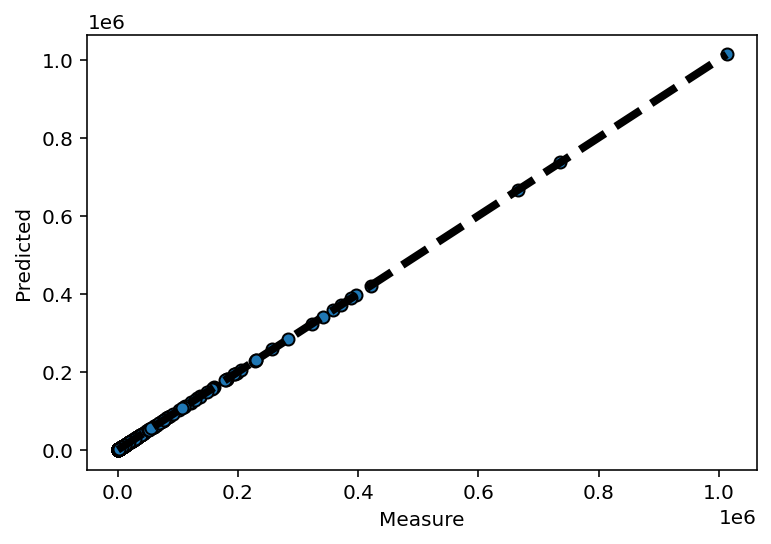

In [295]:
fig,ax=plt.subplots()
ax.scatter(test_labels,prediction,edgecolors=(0,0,0))
ax.plot([test_labels.min(),test_labels.max()],[test_labels.min(),test_labels.max()],'k--',lw=4)
ax.set_xlabel('Measure')
ax.set_ylabel('Predicted')
plt.show

In [296]:
from sklearn.ensemble import RandomForestRegressor
rf=RandomForestRegressor()
model2=rf.fit(train_features,train_labels)
prediction2=rf.predict(test_features)
print('Prediction : ',prediction2[1:100])
errors2=abs(prediction2-test_labels)
print('Error : ',errors2)
print('Mean Absolute Error',round(np.mean(errors2),2))
mape2=100*(errors2/test_labels)
print('MAPE : ',mape2)
accuracy2=100-np.mean(mape2)
print('Accuracy : ',round(accuracy2,2))
print('score : ', model2.score(test_features,test_labels))

Prediction :  [0.00000000e+00 4.03150886e+04 7.79442000e+01 1.38846900e+02
 0.00000000e+00 1.23278500e+02 3.85240700e+02 0.00000000e+00
 5.00098000e+01 2.55095270e+04 3.47859600e+02 0.00000000e+00
 0.00000000e+00 1.63393200e+03 3.28787500e+02 0.00000000e+00
 3.32375830e+03 0.00000000e+00 2.70427300e+02 6.00095000e+01
 0.00000000e+00 8.76006000e+01 2.53431000e+02 7.50674800e+02
 3.33368900e+02 7.97738100e+02 0.00000000e+00 5.00745000e+01
 1.96712500e+02 7.81338000e+01 8.64947870e+03 2.43527500e+02
 2.50231700e+02 1.06295700e+02 0.00000000e+00 3.37567100e+02
 0.00000000e+00 6.74213300e+02 3.09493000e+01 1.04415820e+03
 5.72743220e+03 1.97261000e+02 5.10595600e+02 6.66800000e+01
 3.63192400e+02 0.00000000e+00 6.66705000e+01 5.89996960e+03
 4.05814400e+02 1.64648300e+02 7.31460300e+02 1.01955485e+04
 2.01849900e+02 0.00000000e+00 1.41783600e+02 4.95038500e+02
 3.04498700e+02 1.54995500e+02 0.00000000e+00 1.41786900e+02
 1.09275400e+02 3.63097500e+02 3.97081000e+01 0.00000000e+00
 1.3777540

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: RuntimeWarning: invalid value encountered in true_divide
  if __name__ == '__main__':


<function matplotlib.pyplot.show>

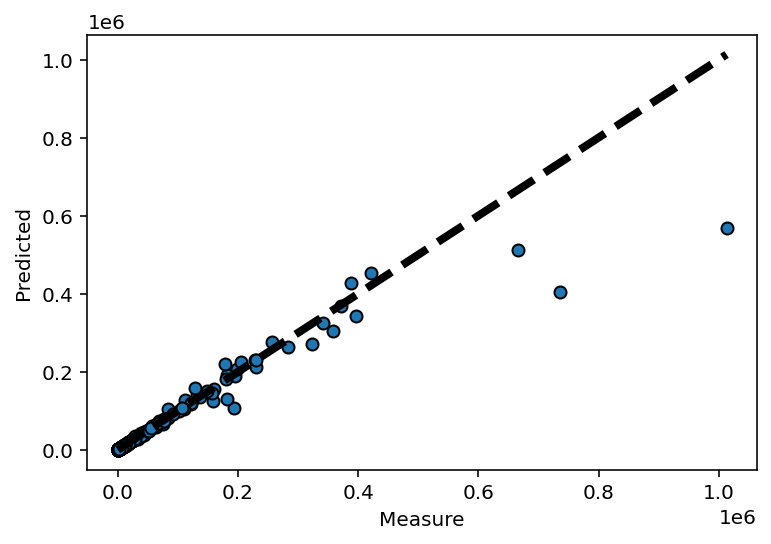

In [297]:
fig,ax=plt.subplots()
ax.scatter(test_labels,prediction2,edgecolors=(0,0,0))
ax.plot([test_labels.min(),test_labels.max()],[test_labels.min(),test_labels.max()],'k--',lw=4)
ax.set_xlabel('Measure')
ax.set_ylabel('Predicted')
plt.show